Auteur : Audrey Hohmann

# Projet P5 : Notebook exploration : Segmentez des clients d'un site e-commerce
 
## Mission : utiliser des méthodes non supervisées pour regrouper des clients de profils similaires. 

## Data : "Brazilian E-Commerce Public Dataset by Olist" : 
Notes : 
- Une commande peut comporter plusieurs articles.
- Chaque article peut être livré par un vendeur distinct.
- Tous les textes identifiant les magasins et les partenaires ont été remplacés par les noms des grandes maisons de Game of Thrones.

In [1]:
%matplotlib inline

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl
import geopandas as gpd
import folium

from matplotlib import pyplot as plt

In [3]:
plt.rcParams['figure.dpi'] = 150

In [203]:
sns.set_theme(context='notebook', style="darkgrid")

In [5]:
pd.options.mode.chained_assignment = None 

In [6]:
pd.set_option('display.max_rows', 5000)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

# Chargement des données

In [7]:
# fichier clients
clients = pd.read_csv('data/olist_customers_dataset.csv')

In [8]:
clients.shape

(99441, 5)

In [9]:
clients.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [10]:
clients.isna().mean().describe()

count    5.0
mean     0.0
std      0.0
min      0.0
25%      0.0
50%      0.0
75%      0.0
max      0.0
dtype: float64

In [11]:
#fichier commandes
order = pd.read_csv('data/olist_orders_dataset.csv')

In [12]:
order.shape

(99441, 8)

In [13]:
order.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [14]:
order.isna().mean().describe().mul(100)

count    800.000000
mean       0.616949
std        1.139308
min        0.000000
25%        0.000000
50%        0.000000
75%        0.568930
max        2.981668
dtype: float64

In [15]:
#fichier montant
montant = pd.read_csv('data/olist_order_payments_dataset.csv')

In [16]:
montant.shape

(103886, 5)

In [17]:
montant.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [18]:
# fichier localisation
geo = pd.read_csv('data/olist_geolocation_dataset.csv')

In [19]:
geo.shape

(1000163, 5)

In [20]:
geo.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [21]:
len(geo['geolocation_zip_code_prefix'].unique())

19015

In [22]:
geo.drop_duplicates(subset=['geolocation_zip_code_prefix'], inplace=True)

In [23]:
geo.isna().mean().mul(100)

geolocation_zip_code_prefix    0.0
geolocation_lat                0.0
geolocation_lng                0.0
geolocation_city               0.0
geolocation_state              0.0
dtype: float64

In [24]:
# table produits commandés
items = pd.read_csv('data/olist_order_items_dataset.csv')

In [25]:
items.tail()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72
112649,fffe41c64501cc87c801fd61db3f6244,1,350688d9dc1e75ff97be326363655e01,f7ccf836d21b2fb1de37564105216cc1,2018-06-12 17:10:13,43.00,12.79


In [26]:
items.shape

(112650, 7)

In [27]:
items.isna().sum()

order_id               0
order_item_id          0
product_id             0
seller_id              0
shipping_limit_date    0
price                  0
freight_value          0
dtype: int64

In [28]:
# table listant les produits
produit = pd.read_csv('data/olist_products_dataset.csv')

In [29]:
produit.shape

(32951, 9)

In [30]:
produit.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [31]:
produit.isna().mean().describe().mul(100)

count    900.000000
mean       0.825468
std        0.973129
min        0.000000
25%        0.006070
50%        0.006070
75%        1.851234
max        1.851234
dtype: float64

In [32]:
trad_produit = pd.read_csv('data/product_category_name_translation.csv')

In [33]:
trad_produit.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [34]:
# table listant les vendeurs
vendeurs = pd.read_csv('data/olist_sellers_dataset.csv')

In [35]:
vendeurs.shape

(3095, 4)

In [36]:
vendeurs.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [37]:
produit.isna().mean().describe().mul(100)

count    900.000000
mean       0.825468
std        0.973129
min        0.000000
25%        0.006070
50%        0.006070
75%        1.851234
max        1.851234
dtype: float64

In [38]:
# table avec les scores de satisfcation
review = pd.read_csv('data/olist_order_reviews_dataset.csv')

In [39]:
review.shape

(99224, 7)

In [40]:
review.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01 00:00:00,2018-03-02 10:26:53


In [41]:
review.isna().mean().describe().mul(100)

count    700.000000
mean      21.006295
std       36.881256
min        0.000000
25%        0.000000
50%        0.000000
75%       29.351266
max       88.341530
dtype: float64

# Nettoyage, analyse exploratoire, 1er feature engineering

## Vérification des valeurs manquantes, des doublons

In [42]:
clients['customer_unique_id'].nunique()

96096

In [43]:
clients.duplicated(subset=['customer_unique_id']).sum()

3345

In [44]:
# les identifiants des clients unique sont dupliqués lorsqu'un même client effectue plusieurs commandes

In [45]:
len(order['order_id'].unique())

99441

In [46]:
order.duplicated(subset=['order_id']).sum()

0

In [47]:
# les order id peuvent être dupliqués dans la table montant car un client peut demander le paiement des commandes avec différents moyens

In [48]:
montant.duplicated(subset=['order_id']).sum()

4446

In [49]:
(montant.loc[montant['order_id'].duplicated(keep=False),:]).sort_values(by=['order_id']).head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
80856,0016dfedd97fc2950e388d2971d718c7,2,voucher,1,17.92
89575,0016dfedd97fc2950e388d2971d718c7,1,credit_card,5,52.63
20036,002f19a65a2ddd70a090297872e6d64e,1,voucher,1,44.11
98894,002f19a65a2ddd70a090297872e6d64e,2,voucher,1,33.18
30155,0071ee2429bc1efdc43aa3e073a5290e,2,voucher,1,92.44


In [50]:
montant.duplicated().sum()

0

In [51]:
len(montant['order_id'].unique())

99440

In [52]:
# les order id peuvent être dupliqués dans la table items car un client peut commander plus qu'un produit différent par commande 

In [53]:
len(items['order_id'].unique())

98666

In [54]:
items.duplicated(subset=['order_id']).sum()

13984

## Creation d'un nouveau df unifié

### 1. Ajout de la table clients

In [55]:
df_commande = order.merge(clients, on='customer_id', how='left')

In [56]:
df_commande.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,barreiras,BA
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,7c142cf63193a1473d2e66489a9ae977,59296,sao goncalo do amarante,RN
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,72632f0f9dd73dfee390c9b22eb56dd6,9195,santo andre,SP


In [57]:
df_commande.shape

(99441, 12)

### 2. Ajout de la table montant

In [58]:
df_mcommande = df_commande.merge(montant, on='order_id', how='left')

In [59]:
df_mcommande.shape

(103887, 16)

In [60]:
df_mcommande.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 175
order_delivered_carrier_date     1888
order_delivered_customer_date    3132
order_estimated_delivery_date       0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
payment_sequential                  1
payment_type                        1
payment_installments                1
payment_value                       1
dtype: int64

In [61]:
df_mcommande = df_mcommande.dropna(how='all', subset=['payment_value'])

In [62]:
df_mcommande.shape

(103886, 16)

In [63]:
# même nombre de commande dupliquée dans la table montant
df_mcommande.duplicated(subset=['order_id']).sum()

4446

### Traiter les types de données

In [64]:
time_columns = ['order_purchase_timestamp', 'order_approved_at','order_delivered_carrier_date','order_delivered_customer_date', 'order_estimated_delivery_date']
df_mcommande[time_columns] = df_mcommande[time_columns].apply(pd.to_datetime)

In [65]:
df_mcommande[['customer_zip_code_prefix']] = df_mcommande[['customer_zip_code_prefix']].astype('object')

In [66]:
df_mcommande.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 103886 entries, 0 to 103886
Data columns (total 16 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       103886 non-null  object        
 1   customer_id                    103886 non-null  object        
 2   order_status                   103886 non-null  object        
 3   order_purchase_timestamp       103886 non-null  datetime64[ns]
 4   order_approved_at              103711 non-null  datetime64[ns]
 5   order_delivered_carrier_date   101998 non-null  datetime64[ns]
 6   order_delivered_customer_date  100754 non-null  datetime64[ns]
 7   order_estimated_delivery_date  103886 non-null  datetime64[ns]
 8   customer_unique_id             103886 non-null  object        
 9   customer_zip_code_prefix       103886 non-null  object        
 10  customer_city                  103886 non-null  object        
 11  

In [67]:
df_mcommande.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,credit_card,1.0,18.12
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,3.0,voucher,1.0,2.00
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2.0,voucher,1.0,18.59
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1.0,boleto,1.0,141.46
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,3a653a41f6f9fc3d2a113cf8398680e8,75265,vianopolis,GO,1.0,credit_card,3.0,179.12


In [68]:
df_mcommande.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [69]:
# La période complète des commandes porte sur 22 mois d’octobre 2016 à août 2018. 

In [70]:
print(df_mcommande['order_purchase_timestamp'].min(), df_mcommande['order_purchase_timestamp'].max())

2016-09-04 21:15:19 2018-10-17 17:30:18


## Analyse exploratoire du fichier de commandes unifié

### Analyse géographique

In [71]:
df_mcommande.shape

(103886, 16)

In [72]:
df_visugeo = df_mcommande.merge(geo, how='inner', left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix')

In [73]:
df_visugeo.shape

(103599, 21)

In [74]:
df_visugeo.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,credit_card,1.0,18.12,3149,-23.574809,-46.587471,sao paulo,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,3.0,voucher,1.0,2.00,3149,-23.574809,-46.587471,sao paulo,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,2.0,voucher,1.0,18.59,3149,-23.574809,-46.587471,sao paulo,SP
3,70b35acffdf851e782ebf6fbc35eb620,8e8ee9b08afb49b080d193f98b0505af,delivered,2018-03-22 17:23:21,2018-03-22 18:05:36,2018-03-23 18:03:03,2018-03-25 17:22:41,2018-04-04,8a4002923e801e3120a11070fd31c9e2,3149,sao paulo,SP,1.0,credit_card,2.0,223.38,3149,-23.574809,-46.587471,sao paulo,SP
4,69923a4e07ce446644394df37a710286,31f31efcb333fcbad2b1371c8cf0fa84,delivered,2017-09-04 11:26:38,2017-09-04 11:43:25,2017-09-04 21:22:15,2017-09-05 19:20:20,2017-09-15,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1.0,credit_card,1.0,44.11,3149,-23.574809,-46.587471,sao paulo,SP


In [75]:
df_visugeo.nunique()

order_id                         99162
customer_id                      99162
order_status                         8
order_purchase_timestamp         98600
order_approved_at                90497
order_delivered_carrier_date     80825
order_delivered_customer_date    95403
order_estimated_delivery_date      458
customer_unique_id               95827
customer_zip_code_prefix         14837
customer_city                     4074
customer_state                      27
payment_sequential                  29
payment_type                         5
payment_installments                24
payment_value                    29047
geolocation_zip_code_prefix      14837
geolocation_lat                  14833
geolocation_lng                  14834
geolocation_city                  4200
geolocation_state                   27
dtype: int64

In [76]:
# visualisation du nombre de clients détaillée par code postale

In [77]:
geo_count = df_visugeo.groupby(['customer_unique_id'])[['geolocation_zip_code_prefix']].sum().value_counts().reset_index(drop=False)

In [78]:
geo_count.columns = ['geolocation_zip_code_prefix', 'nbre_clients']

In [79]:
geo_count.shape

(18184, 2)

In [80]:
geo_count[geo_count['nbre_clients'] == geo_count['nbre_clients'].max()]

,geolocation_zip_code_prefix,nbre_clients
0,22790,128


In [81]:
geo_count[geo_count['nbre_clients'] == geo_count['nbre_clients'].min()]

,geolocation_zip_code_prefix,nbre_clients
12329,83390,1
12330,79470,1
12331,364680,1
12332,89530,1
12333,179960,1
...,...,...
18179,53120,1
18180,53050,1
18181,53010,1
18182,52890,1


In [82]:
print(geo_count[['nbre_clients']].sum())

nbre_clients    95827
dtype: int64


In [83]:
#creation de la variable geometry pour analyse géographique
df_visugeo['geom'] = gpd.points_from_xy(df_visugeo['geolocation_lng'], df_visugeo['geolocation_lat'], crs="EPSG:4326")

In [84]:
geo_count = geo_count.merge(df_visugeo[['geolocation_zip_code_prefix', 'geom']].drop_duplicates(), on = 'geolocation_zip_code_prefix', how='left')

In [85]:
geo_count.isna().sum()

geolocation_zip_code_prefix       0
nbre_clients                      0
geom                           3544
dtype: int64

In [86]:
geo_count = geo_count.dropna(how='all', subset=['geom'])

In [87]:
geo_count.shape

(14640, 3)

In [88]:
gdf = gpd.GeoDataFrame(geo_count, geometry="geom", crs="EPSG:4326")

In [89]:
gdf.head()

,geolocation_zip_code_prefix,nbre_clients,geom
0,22790,128,POINT (-43.45026 -23.01133)
1,22793,114,POINT (-43.42941 -23.00927)
2,24230,108,POINT (-43.10515 -22.91127)
3,24220,99,POINT (-43.10699 -22.90582)
4,22775,98,POINT (-43.39706 -22.97296)


In [90]:
gdf['geolocation_zip_code_prefix'].nunique()

14640

In [91]:
m = folium.Map(location=[-22, -43], tiles="OpenStreetMap", zoom_start=4, width=1000, height=1000)
latitudes = gdf["geom"].apply(lambda point: point.y)
longitudes = gdf["geom"].apply(lambda point: point.x)
for i in range(0,len(gdf)):
   label = '<BR>Nbre clients: {}'.format(gdf.iloc[i]['nbre_clients']) 
   folium.CircleMarker(
      location= [latitudes.iloc[i],longitudes.iloc[i]],
      radius=float(gdf.iloc[i]['nbre_clients']),
        popup=label,
      color='#69b3a2',
      fill=True,
      fill_color='#69b3a2'
   ).add_to(m)
m

In [92]:
m.save('folium_nbre_client_zipcode.html')

In [93]:
# Visulation du nombre de clients par nom de grandes villes 

In [94]:
df_visugeo.nunique()

order_id                         99162
customer_id                      99162
order_status                         8
order_purchase_timestamp         98600
order_approved_at                90497
order_delivered_carrier_date     80825
order_delivered_customer_date    95403
order_estimated_delivery_date      458
customer_unique_id               95827
customer_zip_code_prefix         14837
customer_city                     4074
customer_state                      27
payment_sequential                  29
payment_type                         5
payment_installments                24
payment_value                    29047
geolocation_zip_code_prefix      14837
geolocation_lat                  14833
geolocation_lng                  14834
geolocation_city                  4200
geolocation_state                   27
geom                             14834
dtype: int64

In [95]:
# Group the geolocation data by city and compute the mean latitude and longitude
df_state = df_visugeo.groupby('geolocation_city')[['geolocation_lat', 'geolocation_lng']].mean().reset_index()

In [96]:
# Create a Folium map centered on the center of Brazil
m1 = folium.Map(location=[-22,-43], zoom_start=4, tiles="OpenStreetMap",width=1000, height=1000)

# Add a circle marker for each city with size and color based on the number of customers
for i in range(len(df_state)):
    customers = df_visugeo[df_visugeo['geolocation_city']==df_state.loc[i, 'geolocation_city']]
    customers_count = len(customers)
    label = '<BR>Nbre clients: {}'.format(customers_count) 
    lat = df_state.loc[i, 'geolocation_lat']
    lon = df_state.loc[i, 'geolocation_lng']
   
    if customers_count > 1000:
        color = '#1b3f8b'
    elif customers_count > 100:
        color = '#2166ac'
    elif customers_count > 10:
        color = '#4292c6'
    else:
        color = '#6baed6'
    folium.CircleMarker(location=[lat, lon], radius=customers_count/500, color=color,  popup = label, fill=True, fill_color=color).add_to(m1)

# Add a legend to the map
legend_html = '''
     <div style="position: fixed; 
     bottom: 1000px; left: 1000px; width: 200px; height: 120px; 
     border:2px solid grey; z-index:9999; font-size:14px;
     ">&nbsp; Nombre de clients : <br>
     <i class="fa fa-circle fa-1x" style="color:#1b3f8b"></i> &nbsp > 1000 &nbsp<br>
     <i class="fa fa-circle fa-1x" style="color:#2166ac"></i> &nbsp > 100 &nbsp<br>
     <i class="fa fa-circle fa-1x" style="color:#4292c6"></i> &nbsp > 10 &nbsp<br>
     <i class="fa fa-circle fa-1x" style="color:#6baed6"></i> &nbsp < 10 &nbsp
      </div>
     '''
m1.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m1

### Etude des variables catégorielles 

In [97]:
df_mcommande['order_status'].unique()

array(['delivered', 'invoiced', 'shipped', 'processing', 'unavailable',
       'canceled', 'created', 'approved'], dtype=object)

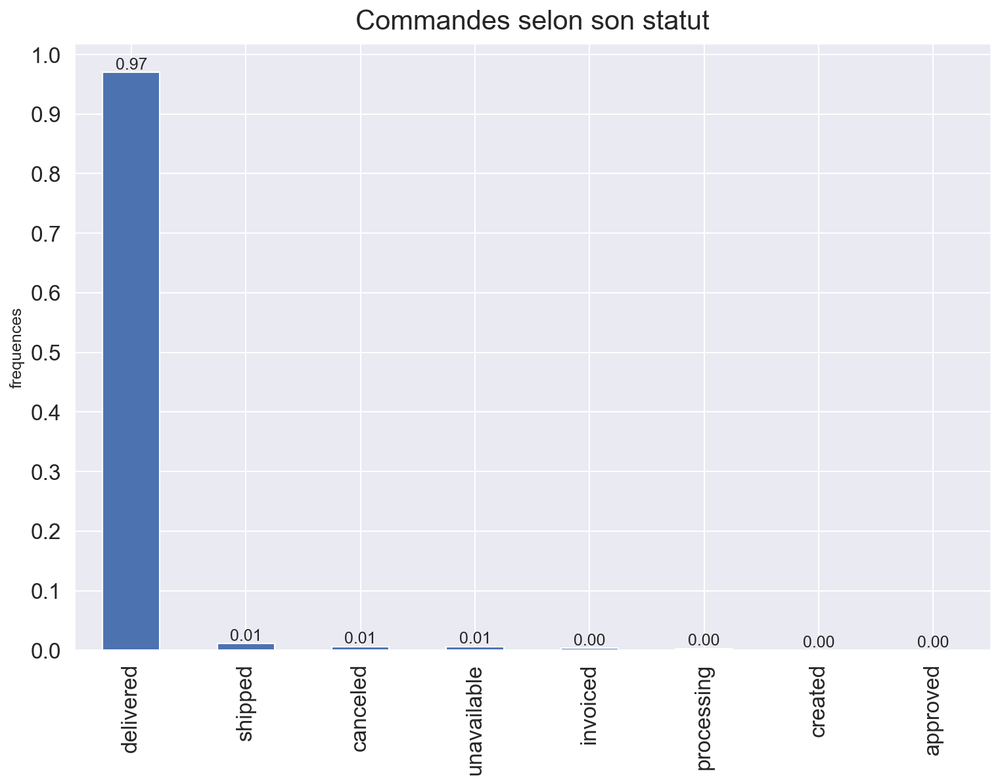

In [98]:
# répartition en % selon le statut des commandes
fig, ax = plt.subplots()
g = df_mcommande['order_status'].value_counts(normalize=True).plot(kind='bar', figsize=(12,8), yticks= np.arange(0, 1.1, 0.1), ylabel="frequences", fontsize=16)
ax.bar_label(ax.containers[0], fmt='%.2f')
plt.title('Commandes selon son statut', fontdict = {'fontsize': 20}, pad = 10.5)
plt.show()

In [99]:
df_mcommande['customer_state'].unique()

array(['SP', 'BA', 'GO', 'RN', 'PR', 'RS', 'RJ', 'MG', 'SC', 'RR', 'PE',
       'TO', 'CE', 'DF', 'SE', 'MT', 'PB', 'PA', 'RO', 'ES', 'AP', 'MS',
       'MA', 'PI', 'AL', 'AC', 'AM'], dtype=object)

In [100]:
df_mcommande['payment_type'].unique()

array(['credit_card', 'voucher', 'boleto', 'debit_card', 'not_defined'],
      dtype=object)

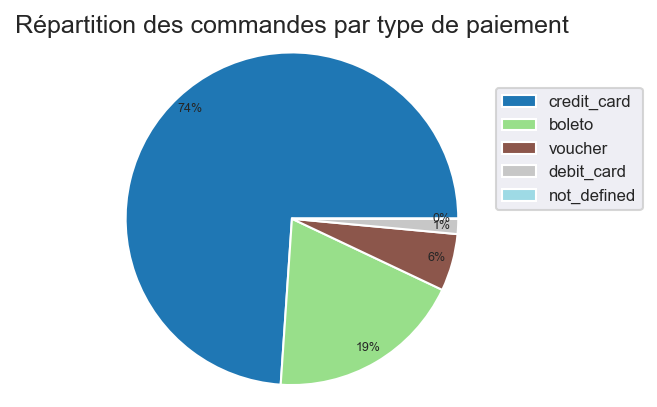

In [101]:
df1=df_mcommande['payment_type'].value_counts(normalize=True)
lab=df1.index.unique()
pie = df1.plot.pie(labels=None, figsize=(5,3), startangle=0, title="Répartition des commandes par type de paiement",
                   autopct='%1.0f%%', pctdistance=0.9, radius=1.2, colormap='tab20', fontsize=6)
pie.legend(lab, loc='lower center', bbox_to_anchor=(0.8, 0.5, 1, 1), fontsize=8)
pie.axes.get_yaxis().set_visible(False)
plt.show()

In [102]:
# Analyser par exemple la distribution du nombre de commandes par client, la distribution des montants, la distribution des catégories des produit etc.

### Distribution du nombre de commandes par client

In [103]:
df_comclient = pd.DataFrame((df_mcommande.groupby(['order_id','customer_unique_id'])[['customer_id']].count()).value_counts()).reset_index(drop=False)

In [104]:
df_comclient.columns = ['nbcommandes', 'nb_clients']

In [105]:
df_comclient

,nbcommandes,nb_clients
0,1,96479
1,2,2382
2,3,301
3,4,108
4,5,52
5,6,36
6,7,28
7,8,11
8,9,9
9,12,8


In [106]:
# fréquence d'apparition du nbre de commandes par clients
df_comclient['f'] = df_comclient['nb_clients'] / df_mcommande['order_id'].nunique()

In [107]:
# Fréquences cumulées
df_comclient['F'] = df_comclient['f'].cumsum()

In [108]:
df_comclient
# seulement 3 % des clients ont réalisé plus de 1 commande et 1 % des clients ont réalisé plus de 2 commandes

,nbcommandes,nb_clients,f,F
0,1,96479,0.970223,0.970223
1,2,2382,0.023954,0.994177
2,3,301,0.003027,0.997204
3,4,108,0.001086,0.998290
4,5,52,0.000523,0.998813
5,6,36,0.000362,0.999175
6,7,28,0.000282,0.999457
7,8,11,0.000111,0.999568
8,9,9,0.000091,0.999658
9,12,8,0.000080,0.999739


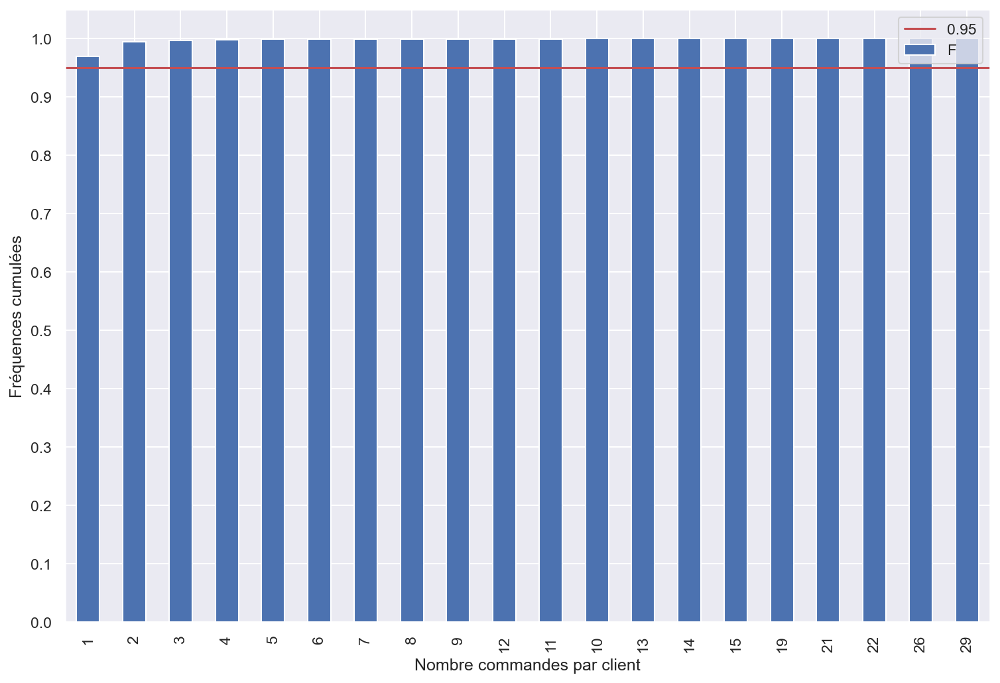

In [109]:
df_comclient.plot(y='F', x='nbcommandes', kind='bar',figsize=(12,8), yticks= np.arange(0, 1.1, 0.1), xlabel="Nombre commandes par client", ylabel="Fréquences cumulées")
plt.axhline(y=0.95, color='r', label='0.95', linestyle='-')
plt.legend(loc ='upper right')

plt.show()

### On enlève les commandes avec statut autre que délivrée et les commandes avec le moyen de paiement non défini

In [110]:
df_mcommande = df_mcommande[(df_mcommande['order_status']== 'delivered') & (df_mcommande['payment_type']!='not_defined')]

In [111]:
df_mcommande.shape

(100756, 16)

### Distribution des montants par commande délivrée

In [112]:
df_totmontant = pd.DataFrame(df_mcommande.groupby(['order_id'])[['payment_value']].sum()).reset_index(drop=False)

In [113]:
df_totmontant.columns = ['order_id', 'Total_montant']

In [114]:
df_totmontant.describe()

,Total_montant
count,96477.000000
mean,159.856357
std,218.813144
min,9.590000
25%,61.880000
50%,105.280000
75%,176.330000
max,13664.080000


In [115]:
df_totmontant['Total_montant'].median()

105.28

In [116]:
df_totmontant['Total_montant'].mode()

0    77.57
Name: Total_montant, dtype: float64

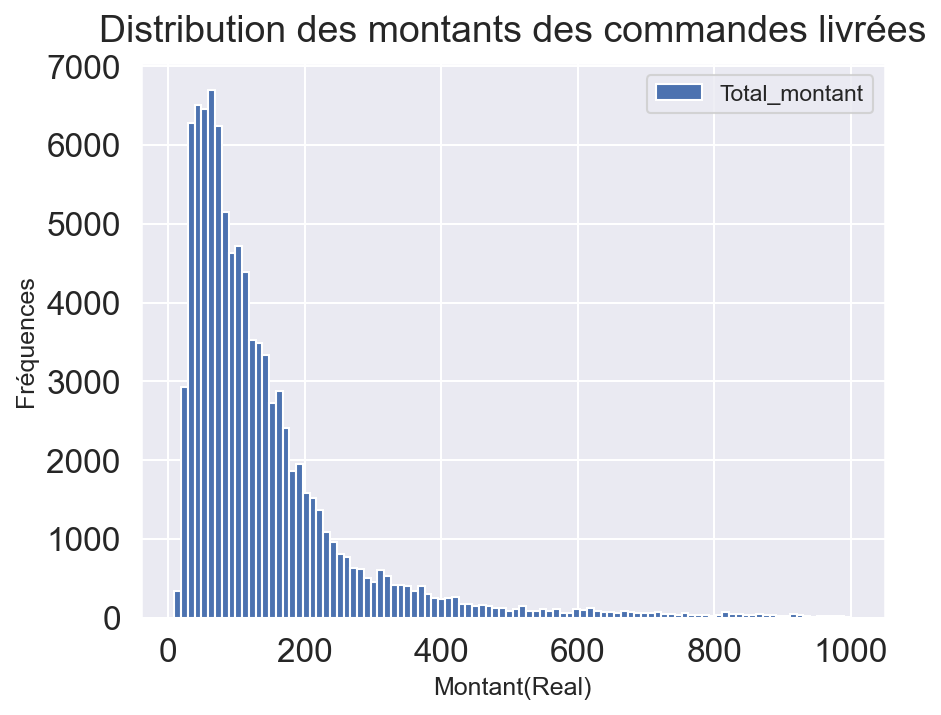

In [117]:
ax = df_totmontant[df_totmontant['Total_montant'] < 1000].plot(kind='hist', bins=100, fontsize=16)
ax.set_xlabel("Montant(Real)")
ax.set_ylabel("Fréquences")
plt.title('Distribution des montants des commandes livrées', fontdict = {'fontsize': 18}, pad = 10.5)
plt.show()

### 3 Ajout de la table items à la table commande unifiée

In [118]:
df_mcommande = df_mcommande.merge(items, on='order_id', how='left')

In [119]:
df_mcommande.duplicated(subset=['order_id']).sum()

18558

In [120]:
df_mcommande.isna().sum()

order_id                          0
customer_id                       0
order_status                      0
order_purchase_timestamp          0
order_approved_at                15
order_delivered_carrier_date      2
order_delivered_customer_date     8
order_estimated_delivery_date     0
customer_unique_id                0
customer_zip_code_prefix          0
customer_city                     0
customer_state                    0
payment_sequential                0
payment_type                      0
payment_installments              0
payment_value                     0
order_item_id                     0
product_id                        0
seller_id                         0
shipping_limit_date               0
price                             0
freight_value                     0
dtype: int64

In [121]:
df_mcommande.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115035 entries, 0 to 115034
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115035 non-null  object        
 1   customer_id                    115035 non-null  object        
 2   order_status                   115035 non-null  object        
 3   order_purchase_timestamp       115035 non-null  datetime64[ns]
 4   order_approved_at              115020 non-null  datetime64[ns]
 5   order_delivered_carrier_date   115033 non-null  datetime64[ns]
 6   order_delivered_customer_date  115027 non-null  datetime64[ns]
 7   order_estimated_delivery_date  115035 non-null  datetime64[ns]
 8   customer_unique_id             115035 non-null  object        
 9   customer_zip_code_prefix       115035 non-null  object        
 10  customer_city                  115035 non-null  object        
 11  

In [122]:
df_mcommande[['order_item_id']] = df_mcommande[['order_item_id']].astype('object')

In [123]:
(df_mcommande.loc[df_mcommande['order_item_id'].isna()]).groupby(['order_status'])['order_id'].count()

Series([], Name: order_id, dtype: int64)

In [124]:
df_mcommande.shape

(115035, 22)

In [125]:
df_mcommande['order_item_id'].unique()

array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21], dtype=object)

In [126]:
df_mcommande['order_item_id'].value_counts()

1     100756
2      10069
3       2331
4        958
5        451
6        255
7         60
8         36
9         28
10        25
11        17
12        13
13         8
14         7
15         5
16         3
17         3
18         3
19         3
20         3
21         1
Name: order_item_id, dtype: int64

In [127]:
df_mcommande.loc[df_mcommande['order_item_id'].isna()].head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value


In [128]:
df_mcommande.groupby(['order_id'])['order_item_id'].sum().value_counts()

1      84242
3       7436
2       2090
6       1490
10       487
15       193
21       190
4         94
5         49
12        33
9         29
7         26
28        21
36        11
8         10
20         9
11         8
55         8
18         7
30         6
78         5
66         4
45         3
24         3
13         3
14         2
120        2
105        2
42         2
84         2
210        2
40         1
91         1
22         1
231        1
126        1
26         1
19         1
57         1
Name: order_item_id, dtype: int64

In [129]:
# test pour retrouver les 3 % de client ayant effectué plus de 1 commande
(df_mcommande.groupby(['order_id','customer_unique_id', 'order_item_id'])[['customer_id']].count().value_counts()) / (df_mcommande.groupby(['order_id','customer_unique_id', 'order_item_id'])[['customer_id']].count().value_counts()).sum()

customer_id
1              0.970761
2              0.023504
3              0.002949
4              0.001116
5              0.000517
6              0.000372
7              0.000281
12             0.000100
8              0.000091
11             0.000073
9              0.000064
10             0.000036
13             0.000027
19             0.000027
21             0.000027
14             0.000018
15             0.000018
22             0.000009
26             0.000009
dtype: float64

### 4. ajout de la table produits

In [130]:
df_mcommande = df_mcommande.merge(produit, on='product_id', how='left')

In [131]:
df_mcommande.shape

(115035, 30)

In [132]:
df_mcommande = df_mcommande.merge(trad_produit, on='product_category_name', how='left')

In [133]:
df_mcommande.shape

(115035, 31)

### Distribution des catégories de produits

In [134]:
# Quelles sont les catégories de produits les plus performantes et les moins performantes en termes de nombre de commandes ?

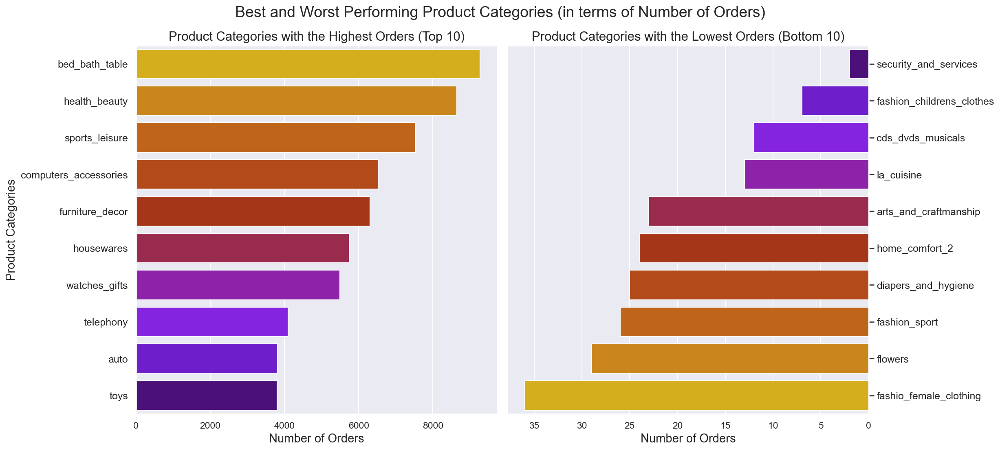

In [135]:
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (16.5, 7.5))

prodCat_TopOrders = df_mcommande.groupby(df_mcommande['product_category_name_english'])['order_id'].nunique().reset_index().sort_values('order_id', ascending = False)
sns.barplot(x = 'order_id', y = 'product_category_name_english', data = prodCat_TopOrders[:10], palette = 'gnuplot_r', ax = ax[0])
ax[0].set_xlabel("Number of Orders", fontsize = 14)
ax[0].set_ylabel("Product Categories", fontsize = 14)
ax[0].tick_params(axis = 'y', labelsize = 12)
ax[0].set_title("Product Categories with the Highest Orders (Top 10)", fontsize = 15)

prodCat_BotOrders = df_mcommande.groupby(df_mcommande['product_category_name_english'])['order_id'].nunique().reset_index().sort_values('order_id', ascending = True)
sns.barplot(x = 'order_id', y = 'product_category_name_english', data = prodCat_BotOrders[:10], palette = 'gnuplot', ax = ax[1])
ax[1].set_xlabel("Number of Orders", fontsize = 14)
ax[1].set_ylabel("")
ax[1].invert_xaxis()
ax[1].yaxis.set_label_position("right")
ax[1].yaxis.tick_right()
ax[1].tick_params(axis = 'y', labelsize = 12)
ax[1].set_title("Product Categories with the Lowest Orders (Bottom 10)", fontsize = 15)

plt.suptitle("Best and Worst Performing Product Categories (in terms of Number of Orders)", fontsize = 18)
plt.tight_layout(pad = 1)
plt.show()

In [136]:
# Quelles sont les catégories de produits les plus performantes et les moins performantes en termes de revenus totaux générés ?

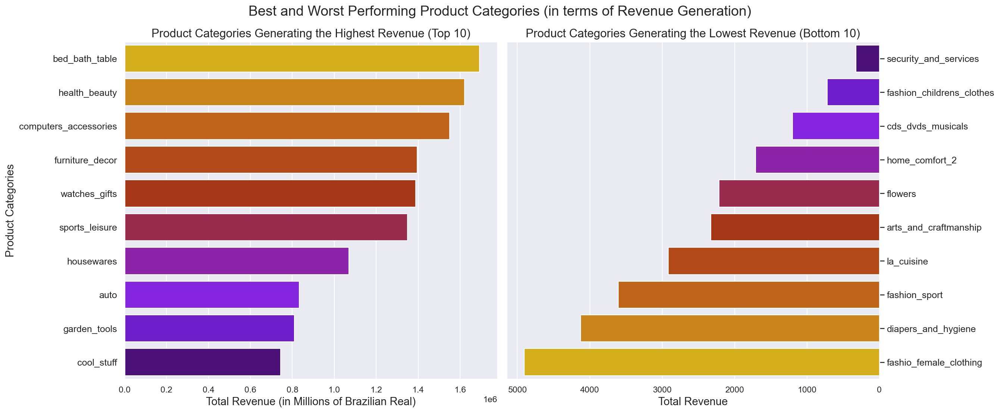

In [137]:
fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (18, 7.5))

prodCat_TopRevenue = df_mcommande.groupby(df_mcommande['product_category_name_english'])['payment_value'].sum().reset_index().sort_values('payment_value', ascending = False)
sns.barplot(x = 'payment_value', y = 'product_category_name_english', data = prodCat_TopRevenue[:10], palette = 'gnuplot_r', ax = ax[0])
ax[0].set_xlabel("Total Revenue (in Millions of Brazilian Real)", fontsize = 14)
ax[0].set_ylabel("Product Categories", fontsize = 14)
ax[0].tick_params(axis = 'y', labelsize = 12)
ax[0].set_title("Product Categories Generating the Highest Revenue (Top 10)", fontsize = 15)

prodCat_BotRevenue = df_mcommande.groupby(df_mcommande['product_category_name_english'])['payment_value'].sum().reset_index().sort_values('payment_value', ascending = True)
sns.barplot(x = 'payment_value', y = 'product_category_name_english', data = prodCat_BotRevenue[:10], palette = 'gnuplot', ax = ax[1])
ax[1].set_xlabel("Total Revenue", fontsize = 14)
ax[1].set_ylabel("")
ax[1].invert_xaxis()
ax[1].yaxis.set_label_position("right")
ax[1].yaxis.tick_right()
ax[1].tick_params(axis = 'y', labelsize = 12)
ax[1].set_title("Product Categories Generating the Lowest Revenue (Bottom 10)", fontsize = 15)

plt.suptitle("Best and Worst Performing Product Categories (in terms of Revenue Generation)", fontsize = 18)
plt.tight_layout(pad = 1)
plt.show()

### 5. ajout de la table review

In [138]:
df_mcommande = df_mcommande.merge(review[['order_id','review_score']], on='order_id', how='left')

In [139]:
df_mcommande.shape

(115720, 32)

In [140]:
df_mcommande.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                  15
order_delivered_carrier_date        2
order_delivered_customer_date       8
order_estimated_delivery_date       0
customer_unique_id                  0
customer_zip_code_prefix            0
customer_city                       0
customer_state                      0
payment_sequential                  0
payment_type                        0
payment_installments                0
payment_value                       0
order_item_id                       0
product_id                          0
seller_id                           0
shipping_limit_date                 0
price                               0
freight_value                       0
product_category_name            1638
product_name_lenght              1638
product_description_lenght       1638
product_photos_qty               1638
product_weig

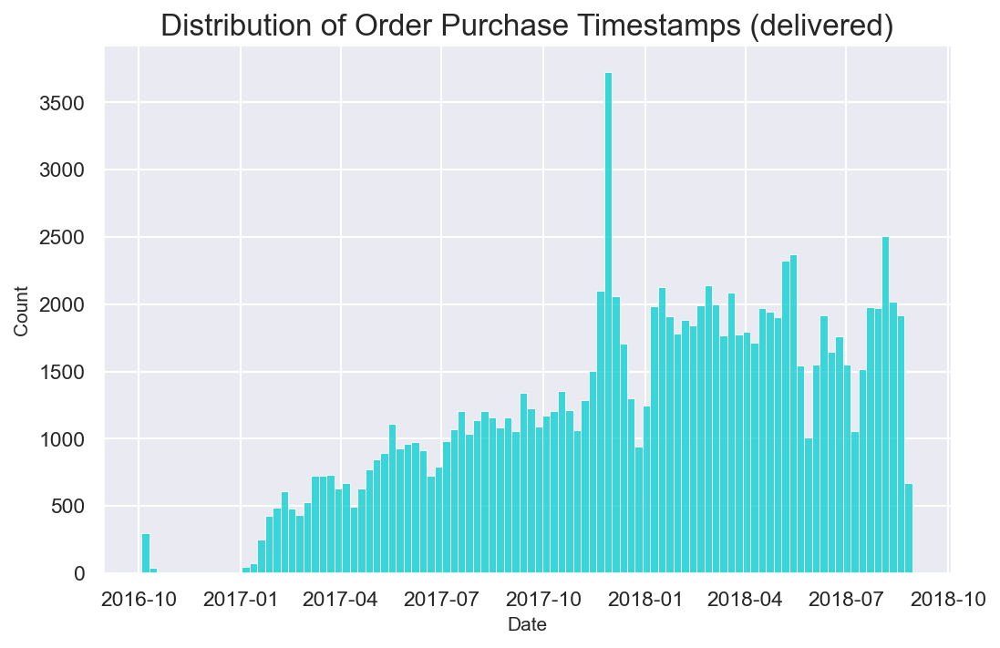

In [204]:
# distribution des commandes livrées selon la date de commandes 
plt.figure(figsize=(8, 5))
sns.histplot(df_mcommande['order_purchase_timestamp'], bins=100, kde=False, color='#00CED1')
plt.title('Distribution of Order Purchase Timestamps (delivered)', fontsize=16)
plt.xlabel('Date', fontsize=10)
plt.ylabel('Count', fontsize=10)
plt.tick_params(axis='both', which='minor', length=12, width=2, labelsize=10)
sns.despine()
plt.show()

# Segmentation RFM (Recence, Frequence, Montant)

In [142]:
# La segmentation RFM prend en compte la Récence (date de la dernière commande), la Fréquence des commandes et le Montant (de la dernière commande ou sur une période donnée) pour établir des segments de clients homogènes.

## Calcul de la Recence

In [143]:
# récupération de la date de la dernière commande pour identifiant unique de clients
df_recency = df_mcommande.groupby(['customer_unique_id'])['order_purchase_timestamp'].max().reset_index()

df_recency.rename(columns = {"order_purchase_timestamp": "LastPurchaseDate"}, inplace = True)

df_recency["LastPurchaseDate"] = df_recency["LastPurchaseDate"].dt.date

#Utilisation de la dernière commande de l'ensemble des données comme point de référence pour calculer la récence :
recent_date = df_mcommande['order_purchase_timestamp'].dt.date.max()
df_recency['Recency'] = df_recency['LastPurchaseDate'].apply(lambda x: (recent_date - x).days)

df_recency.head()

,customer_unique_id,LastPurchaseDate,Recency
0,0000366f3b9a7992bf8c76cfdf3221e2,2018-05-10,111
1,0000b849f77a49e4a4ce2b2a4ca5be3f,2018-05-07,114
2,0000f46a3911fa3c0805444483337064,2017-03-10,537
3,0000f6ccb0745a6a4b88665a16c9f078,2017-10-12,321
4,0004aac84e0df4da2b147fca70cf8255,2017-11-14,288


## Calcul de la Frequence

In [144]:
#Regroupement des données par identifiant unique de client pour calculer le nombre d'identifiants de commande uniques pour chaque client.
frequency_df = df_mcommande.groupby(["customer_unique_id"]).agg({"order_id": "nunique"}).reset_index()

frequency_df.rename(columns = {"order_id": "Frequency"}, inplace = True)

frequency_df.shape

(93357, 2)

## Calcul du Montant

In [145]:
#somme des montants par identifiant client unique
monetary_df = df_mcommande.groupby(['customer_unique_id'])['payment_value'].sum().reset_index()

monetary_df.rename(columns = {"payment_value": "Monetary"}, inplace = True)

monetary_df.head()

,customer_unique_id,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,27.19
2,0000f46a3911fa3c0805444483337064,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,43.62
4,0004aac84e0df4da2b147fca70cf8255,196.89


## Création d'un dataframe RFM

In [146]:
rfm = df_recency.merge(frequency_df, on = 'customer_unique_id') \
                .merge(monetary_df, on = 'customer_unique_id')

rfm.drop('LastPurchaseDate', axis = 1, inplace = True)

rfm.head()

,customer_unique_id,Recency,Frequency,Monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19
2,0000f46a3911fa3c0805444483337064,537,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89


In [147]:
rfm.describe()

,Recency,Frequency,Monetary
count,93357.000000,93357.000000,93357.000000
mean,237.473783,1.033420,212.966838
std,152.587935,0.209099,646.226951
min,0.000000,1.000000,9.590000
25%,114.000000,1.000000,63.830000
50%,218.000000,1.000000,113.140000
75%,346.000000,1.000000,202.640000
max,695.000000,15.000000,109312.640000


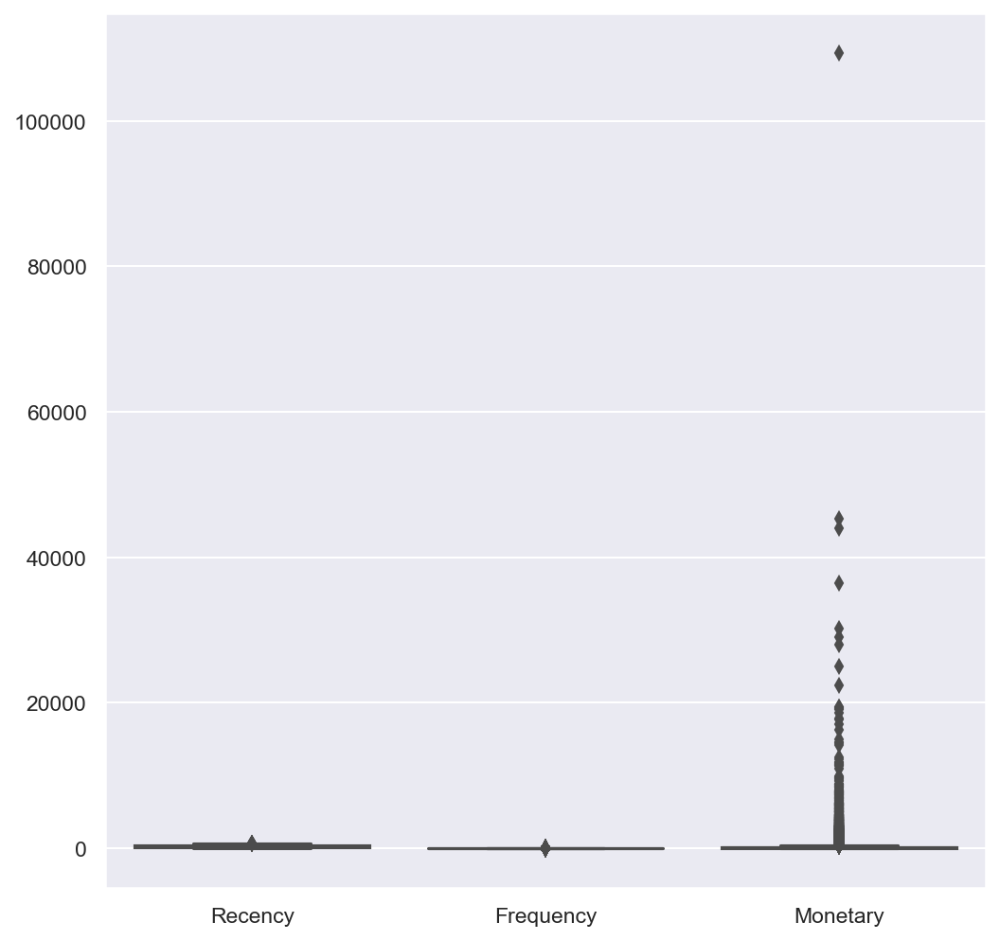

In [148]:
plt.figure(figsize = (8, 8))
sns.boxplot(data = rfm);

In [149]:
print("Skew recency :" ,  rfm['Recency'].skew())
print("Skew Frequency :" , rfm['Frequency'].skew())
print("Skew Monetary :" , rfm['Monetary'].skew())

Skew recency : 0.4473301799393481
Skew Frequency : 11.095096335921797
Skew Monetary : 69.29350972296984


In [150]:
rfm = rfm[rfm['Monetary'] < 60000]

In [151]:
rfm.describe()

,Recency,Frequency,Monetary
count,93356.000000,93356.00000,93356.000000
mean,237.472749,1.03342,211.798196
std,152.588425,0.20910,538.621050
min,0.000000,1.00000,9.590000
25%,114.000000,1.00000,63.830000
50%,218.000000,1.00000,113.140000
75%,346.000000,1.00000,202.632500
max,695.000000,15.00000,45256.000000


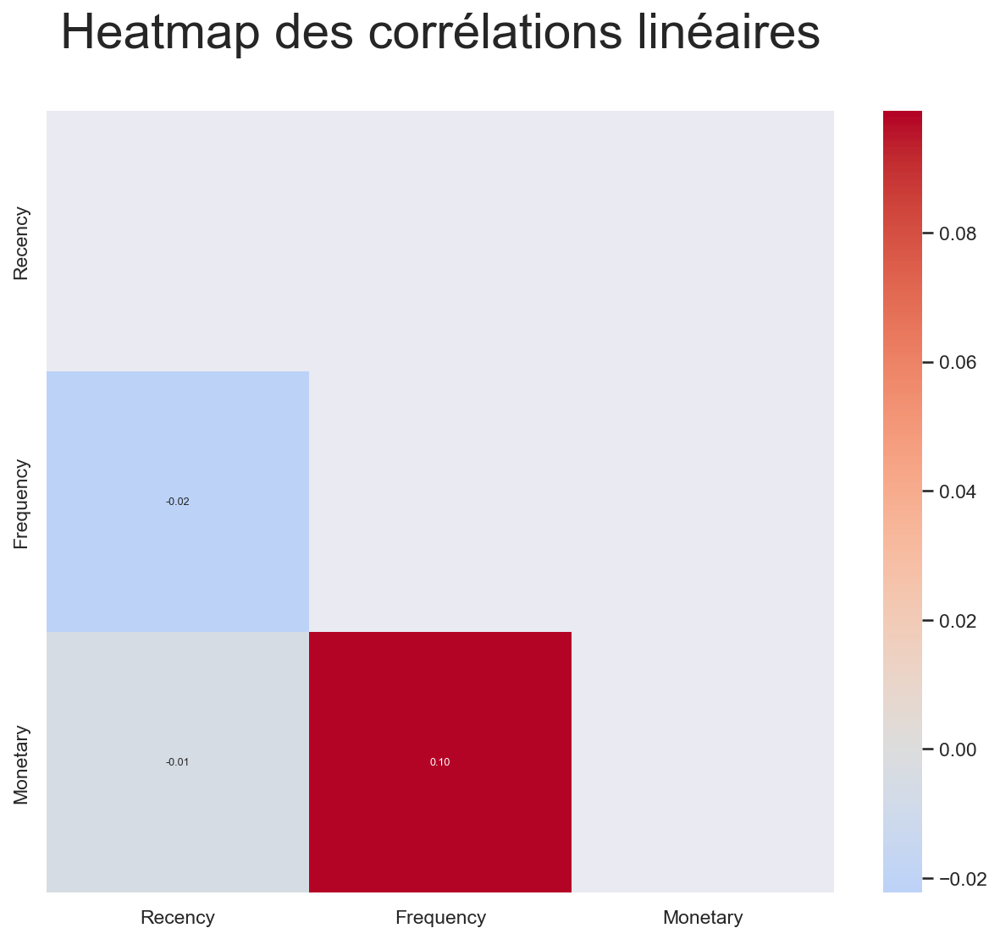

In [152]:
corr = rfm.select_dtypes(include=np.number).corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
fig, ax = plt.subplots(figsize=(10,8))
ax = sns.heatmap(corr, annot=True, fmt=".2f", annot_kws={'size':6}, 
                 mask=mask, center=0, cmap="coolwarm")
plt.title(f"Heatmap des corrélations linéaires\n", 
          fontsize=28)
plt.show()

Nous pouvons constater une corrélation positive entre fréquence des commandes et montant et une corrélation négative entre la fréquence des commandes et la date de la dernière commande. Aucune corrélation entre le montant des commandes et la date de la dernière commande. 

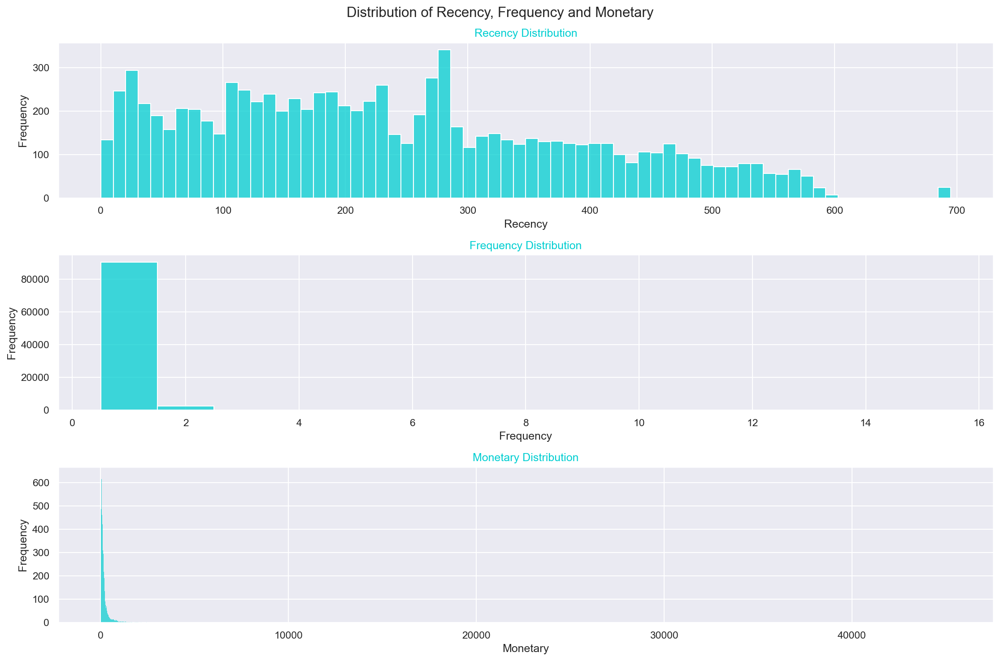

In [153]:
fig, ax = plt.subplots(nrows = 3, ncols = 1, figsize = (15, 10))
sns.histplot(rfm['Recency'], stat='frequency', color='#00CED1', ax = ax[0])
ax[0].set_title("Recency Distribution", color='#00CED1')
sns.histplot(rfm['Frequency'],stat='frequency', discrete=True, color='#00CED1', ax = ax[1])
ax[1].set_title("Frequency Distribution", color='#00CED1')
sns.histplot(rfm['Monetary'], stat='frequency', color='#00CED1', ax = ax[2])
ax[2].set_title("Monetary Distribution", color='#00CED1')
plt.suptitle('Distribution of Recency, Frequency and Monetary', fontsize = 15)
plt.tight_layout(pad = 1)
plt.show()

**Calcul du Skewness empirique : mesure d'asymétrie**

Si γ1=0 alors la distribution est symétrique.

Si γ1>0 alors la distribution est étalée à droite.

Si γ1<0 alors la distribution est étalée à gauche.

In [154]:
print("Skew recency :" ,  rfm['Recency'].skew())
print("Skew Frequency :" , rfm['Frequency'].skew())
print("Skew Monetary :" , rfm['Monetary'].skew())

Skew recency : 0.4473482775972368
Skew Frequency : 11.09503637628108
Skew Monetary : 30.66031086296055


In [155]:
rfm.columns[2:]

Index(['Frequency', 'Monetary'], dtype='object')

In [156]:
rfm_transformed = rfm.copy()
for feature in rfm.columns[2:]:
    rfm_transformed[feature + "_log"] = rfm_transformed[feature].apply(lambda x: np.log(x + 1)) # identique à np.log1p

In [157]:
rfm_transformed.head()

,customer_unique_id,Recency,Frequency,Monetary,Frequency_log,Monetary_log
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,0.693147,4.962145
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,0.693147,3.338967
2,0000f46a3911fa3c0805444483337064,537,1,86.22,0.693147,4.468434
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,0.693147,3.798182
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,0.693147,5.287711


In [158]:
for skew in rfm_transformed[['Recency', 'Frequency_log', 'Monetary_log']].skew():
    if -0.75 < skew < 0.75:
        print ("A skewness value of", '\033[92m', skew, '\033[0m', "means that the distribution is approx.", '\033[92m',"symmetric", '\033[0m')
    elif  -0.75 < skew < -1.0 or 0.75 < skew < 1.0:
        print ("A skewness value of", '\033[33m', skew, '\033[0m', "means that the distribution is approx.", '\033[33m', "moderately skewed", '\033[0m')
    else:
        print ("A skewness value of", '\033[31m', skew, '\033[0m', "means that the distribution is approx.", '\033[31m', "highly skewed", '\033[0m')

A skewness value of  0.4473482775972368  means that the distribution is approx.  symmetric 
A skewness value of  6.521993723620514  means that the distribution is approx.  highly skewed 
A skewness value of  0.7474175548727948  means that the distribution is approx.  symmetric 


In [159]:
from sklearn.preprocessing import PowerTransformer
from sklearn.compose import ColumnTransformer

# définir les indices des colonnes à transformer
cols_to_transform = [2, 3]

# créer le transformateur de colonne
ct = ColumnTransformer(transformers=[('PT', PowerTransformer(method='yeo-johnson'), cols_to_transform)])

# appliquer la transformation et récupérer le résultat dans un nouveau dataframe
df_transformed = pd.DataFrame(ct.fit_transform(rfm_transformed), columns=['Frequency_PT', 'Monetary_PT'])

# concaténer le dataframe original et le dataframe transformé
df_rfm = pd.concat([rfm_transformed, df_transformed], axis=1)

In [160]:
df_rfm.head()

,customer_unique_id,Recency,Frequency,Monetary,Frequency_log,Monetary_log,Frequency_PT,Monetary_PT
0,0000366f3b9a7992bf8c76cfdf3221e2,111.0,1.0,141.90,0.693147,4.962145,0.0,0.285757
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114.0,1.0,27.19,0.693147,3.338967,0.0,-1.949395
2,0000f46a3911fa3c0805444483337064,537.0,1.0,86.22,0.693147,4.468434,0.0,-0.296594
3,0000f6ccb0745a6a4b88665a16c9f078,321.0,1.0,43.62,0.693147,3.798182,0.0,-1.217958
4,0004aac84e0df4da2b147fca70cf8255,288.0,1.0,196.89,0.693147,5.287711,0.0,0.630556


In [161]:
for skew in df_rfm[['Frequency_PT', 'Monetary_PT']].skew():
    if -0.75 < skew < 0.75:
        print ("A skewness value of", '\033[92m', skew, '\033[0m', "means that the distribution is approx.", '\033[92m',"symmetric", '\033[0m')
    elif  -0.75 < skew < -1.0 or 0.75 < skew < 1.0:
        print ("A skewness value of", '\033[33m', skew, '\033[0m', "means that the distribution is approx.", '\033[33m', "moderately skewed", '\033[0m')
    else:
        print ("A skewness value of", '\033[31m', skew, '\033[0m', "means that the distribution is approx.", '\033[31m', "highly skewed", '\033[0m')

A skewness value of  0.0  means that the distribution is approx.  symmetric 
A skewness value of  0.017124551829519677  means that the distribution is approx.  symmetric 


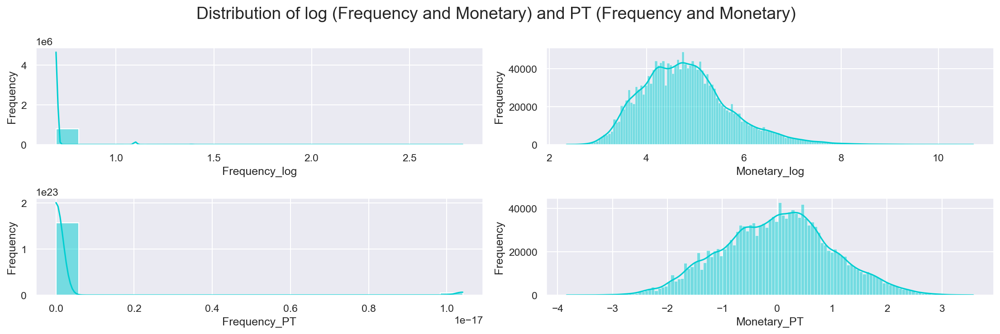

In [162]:
fig, ax = plt.subplots(nrows = 2, ncols = 2, figsize = (15, 5))
sns.histplot(df_rfm['Frequency_log'], stat='frequency', kde = True, color='#00CED1', ax = ax[0,0])
sns.histplot(df_rfm['Monetary_log'], stat='frequency', kde = True, color='#00CED1', ax = ax[0,1])
sns.histplot(df_rfm['Frequency_PT'], stat='frequency', kde = True, color='#00CED1', ax = ax[1,0])
sns.histplot(df_rfm['Monetary_PT'], stat='frequency', kde = True, color='#00CED1', ax = ax[1,1])
plt.suptitle('Distribution of log (Frequency and Monetary) and PT (Frequency and Monetary)', fontsize = 18)
plt.tight_layout(pad = 1)
plt.show()

In [163]:
# tests estimation de coefficient pour transformation

In [164]:
from sklearn.linear_model import LinearRegression

In [165]:
reg = LinearRegression().fit((np.arange(0,93356)/30000).reshape(-1,1),
  rfm_transformed['Frequency_log'].sort_values().reset_index(drop=True).values.reshape(-1, 1))


In [166]:
reg.coef_

array([[0.02445622]])

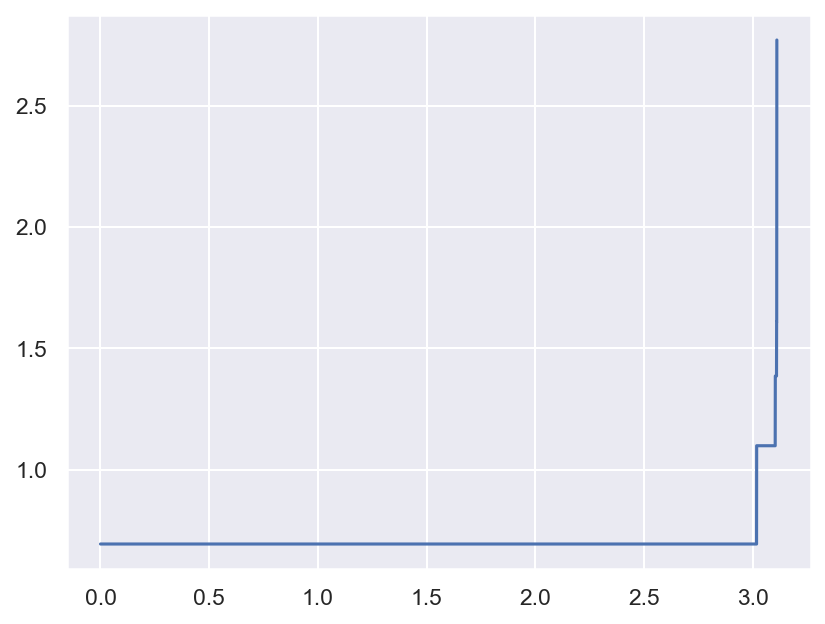

In [167]:
plt.plot(np.arange(0,93356)/30000, rfm_transformed.sort_values('Frequency_log').reset_index(drop=True)['Frequency_log'])

<AxesSubplot: >

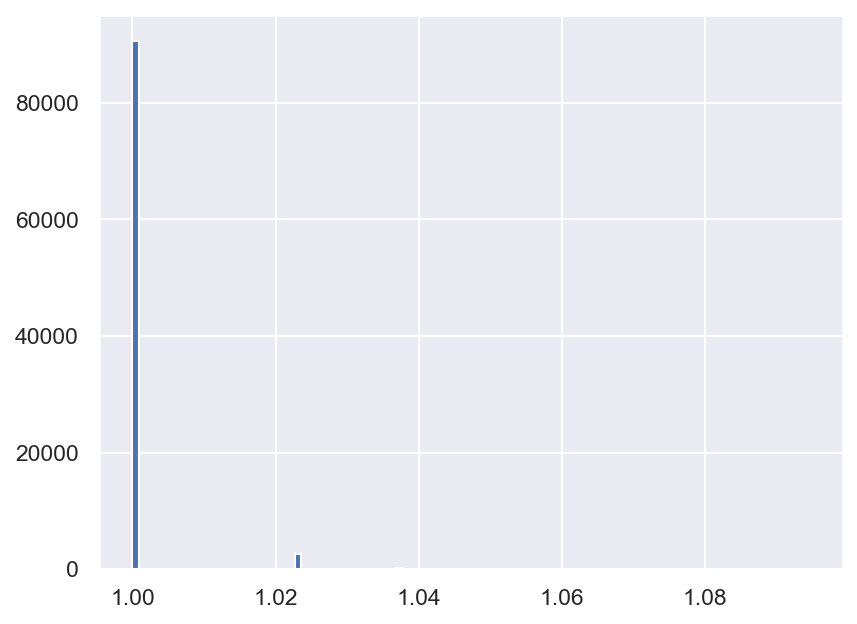

In [168]:
np.power(rfm_transformed['Frequency'], 1/30).hist(bins=100)

# Compute RFM Score

## Classification en 5 classes 

In [169]:
rfm_score = rfm.copy()

In [170]:
q = [.25, .5, .75, .99]

In [171]:
quantiles = rfm_score.quantile(q, axis = 0)
print(quantiles)

      Recency  Frequency   Monetary
0.25    114.0        1.0    63.8300
0.50    218.0        1.0   113.1400
0.75    346.0        1.0   202.6325
0.99    575.0        2.0  1682.7945


/var/folders/qq/7k2dvnz1497ckt2nzxktkkm00000gn/T/ipykernel_62789/3174080788.py:1: FutureWarning: The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  quantiles = rfm_score.quantile(q, axis = 0)


In [172]:
def recency_score (data):
    if data <= 114:
        return 1
    elif data <= 218:
        return 2
    elif data <= 346:
        return 3
    elif data <= 575:
        return 4
    else:
        return 5

def frequency_score (data):
    if data <= 1:
        return 1
    elif data <= 2:
        return 4
    else:
        return 5

def monetary_value_score (data):
    if data <= 63.83:
        return 1
    elif data <= 113.14:
        return 2
    elif data <= 202.64:
        return 3
    elif data <= 1684.27:
        return 4
    else:
        return 5

rfm_score['R'] = rfm_score['Recency'].apply(recency_score )
rfm_score['F'] = rfm_score['Frequency'].apply(frequency_score)
rfm_score['M'] = rfm_score['Monetary'].apply(monetary_value_score)
rfm_score.head()


,customer_unique_id,Recency,Frequency,Monetary,R,F,M
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,1,1,3
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,1,1,1
2,0000f46a3911fa3c0805444483337064,537,1,86.22,4,1,2
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,3,1,3


In [173]:
rfm_score['RFM_score'] = rfm_score[['R', 'F', 'M']].sum(axis=1)
rfm_score.head()

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_score
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,1,1,3,5
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,1,1,1,3
2,0000f46a3911fa3c0805444483337064,537,1,86.22,4,1,2,7
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1,5
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,3,1,3,7


In [174]:
rfm_score.describe()

,Recency,Frequency,Monetary,R,F,M,RFM_score
count,93356.000000,93356.00000,93356.000000,93356.000000,93356.000000,93356.000000,93356.000000
mean,237.472749,1.03342,211.798196,2.506384,1.092453,2.509930,6.108766
std,152.588425,0.20910,538.621050,1.136108,0.527809,1.135753,1.731459
min,0.000000,1.00000,9.590000,1.000000,1.000000,1.000000,3.000000
25%,114.000000,1.00000,63.830000,1.000000,1.000000,1.000000,5.000000
50%,218.000000,1.00000,113.140000,2.000000,1.000000,2.000000,6.000000
75%,346.000000,1.00000,202.632500,3.000000,1.000000,3.000000,7.000000
max,695.000000,15.00000,45256.000000,5.000000,5.000000,5.000000,15.000000


In [175]:
rfm_score['label'] = 'Bronze' 
rfm_score.loc[rfm_score['RFM_score'] > 4, 'label'] = 'Silver' 
rfm_score.loc[rfm_score['RFM_score'] > 6, 'label'] = 'Gold'
rfm_score.loc[rfm_score['RFM_score'] > 8, 'label'] = 'Platinum'
rfm_score.loc[rfm_score['RFM_score'] > 10, 'label'] = 'Diamond'

rfm_score.head()

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_score,label
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,1,1,3,5,Silver
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,1,1,1,3,Bronze
2,0000f46a3911fa3c0805444483337064,537,1,86.22,4,1,2,7,Gold
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1,5,Silver
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,3,1,3,7,Gold


   Silver   Gold  Bronze  Platinum  Diamond
    39743  28159   17243      7162     1049


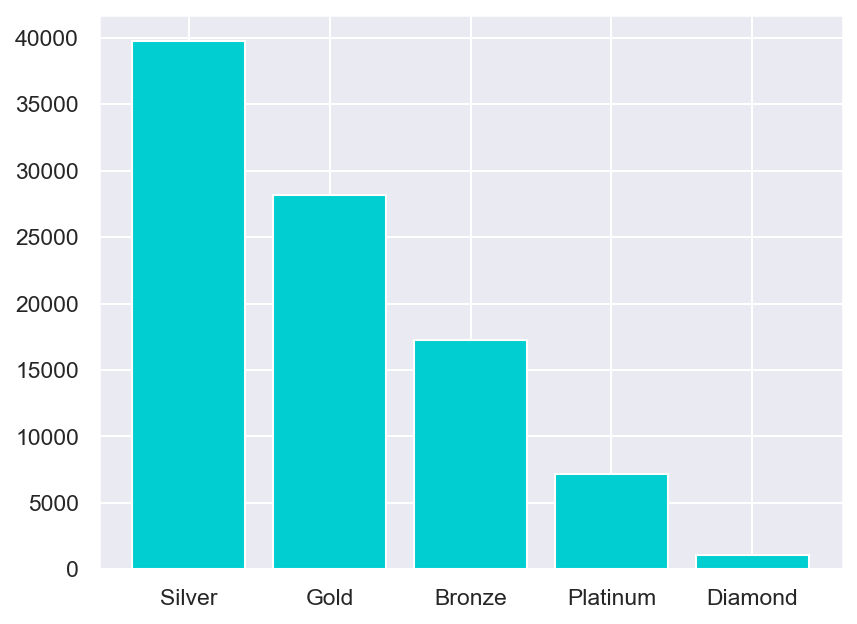

In [176]:
barplot = dict(rfm_score['label'].value_counts())
bar_names = list(barplot.keys())
bar_values = list(barplot.values())
plt.bar(bar_names,bar_values, color='#00CED1')
print(pd.DataFrame(barplot, index=[' ']))

In [177]:
agg_resume = rfm_score[["label", "Recency","Frequency","Monetary"]].groupby("label").agg(["mean","count","max"]).round()

In [178]:
print (agg_resume.sort_values([('Recency','count')],ascending=False))

         Recency             Frequency            Monetary                
            mean  count  max      mean  count max     mean  count      max
label                                                                     
Silver     208.0  39743  575       1.0  39743   2    140.0  39743   1680.0
Gold       322.0  28159  695       1.0  28159   3    292.0  28159  44048.0
Bronze      94.0  17243  218       1.0  17243   1     58.0  17243    113.0
Platinum   395.0   7162  695       1.0   7162  15    589.0   7162  45256.0
Diamond    348.0   1049  693       2.0   1049   9    763.0   1049  27935.0


Bronze : Montant et Recency faible et frequence = 1

Silver : Montant et Recency moyen, Frequence =1 

Gold : Montant moyen, Frequence = 1, Recency élevé

Platinium :  Montant élévé, Frequence = 1 , Recency élevé

Diamond : Montant élévé, Frequence sup à 1, Recency élevé


Possibilité de regrouper en 3 classes : 
Recency =< 100 
Recency 100  < R < 300
Recency >= 300

Frequency = 1 
Frequency > 1

Monetary =< 100
Monetary 100 < m < 500 
Monetary > = 500

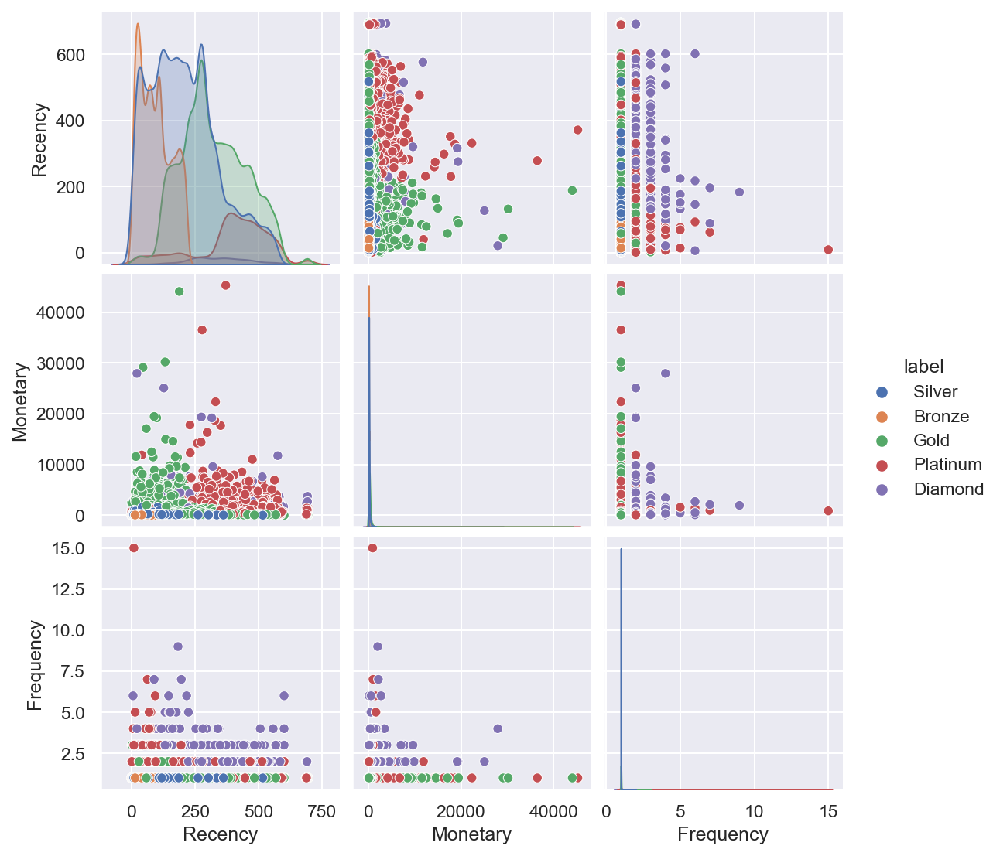

In [179]:
sns.pairplot(rfm_score[['Recency','Monetary','Frequency', 'label']], hue="label")

plt.show()

## Regroupement 3 classes

In [180]:
rfm_score3 = rfm.copy()

In [181]:
def recency_score (data):
    if data <= 100:
        return 1
    elif data <= 300:
        return 2
    else:
        return 3

def frequency_score (data):
    if data <= 1:
        return 1
    elif data <= 2:
        return 2
    else:
        return 3

def monetary_value_score (data):
    if data <= 100:
        return 1
    elif data <= 500:
        return 2
    else:
        return 3

rfm_score3['R'] = rfm_score3['Recency'].apply(recency_score )
rfm_score3['F'] = rfm_score3['Frequency'].apply(frequency_score)
rfm_score3['M'] = rfm_score3['Monetary'].apply(monetary_value_score)
rfm_score3.head()


,customer_unique_id,Recency,Frequency,Monetary,R,F,M
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,2,1,2
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,2,1,1
2,0000f46a3911fa3c0805444483337064,537,1,86.22,3,1,1
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,2


In [182]:
rfm_score3['RFM_score'] = rfm_score3[['R', 'F', 'M']].sum(axis=1)
rfm_score3.head()

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_score
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,2,1,2,5
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,2,1,1,4
2,0000f46a3911fa3c0805444483337064,537,1,86.22,3,1,1,5
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1,5
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,2,5


In [183]:
rfm_score3['label'] = 'Bronze' 
rfm_score3.loc[rfm_score3['RFM_score'] > 4, 'label'] = 'Silver' 
rfm_score3.loc[rfm_score3['RFM_score'] > 6, 'label'] = 'Gold'

rfm_score3.head()

,customer_unique_id,Recency,Frequency,Monetary,R,F,M,RFM_score,label
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90,2,1,2,5,Silver
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19,2,1,1,4,Bronze
2,0000f46a3911fa3c0805444483337064,537,1,86.22,3,1,1,5,Silver
3,0000f6ccb0745a6a4b88665a16c9f078,321,1,43.62,3,1,1,5,Silver
4,0004aac84e0df4da2b147fca70cf8255,288,1,196.89,2,1,2,5,Silver


In [184]:
rfm_score3.describe()

,Recency,Frequency,Monetary,R,F,M,RFM_score
count,93356.000000,93356.00000,93356.000000,93356.000000,93356.000000,93356.000000,93356.000000
mean,237.472749,1.03342,211.798196,2.102714,1.032446,1.629569,4.764729
std,152.588425,0.20910,538.621050,0.719604,0.190468,0.618980,0.979729
min,0.000000,1.00000,9.590000,1.000000,1.000000,1.000000,3.000000
25%,114.000000,1.00000,63.830000,2.000000,1.000000,1.000000,4.000000
50%,218.000000,1.00000,113.140000,2.000000,1.000000,2.000000,5.000000
75%,346.000000,1.00000,202.632500,3.000000,1.000000,2.000000,5.000000
max,695.000000,15.00000,45256.000000,3.000000,3.000000,3.000000,9.000000


   Silver  Bronze  Gold
    52962   37256  3138


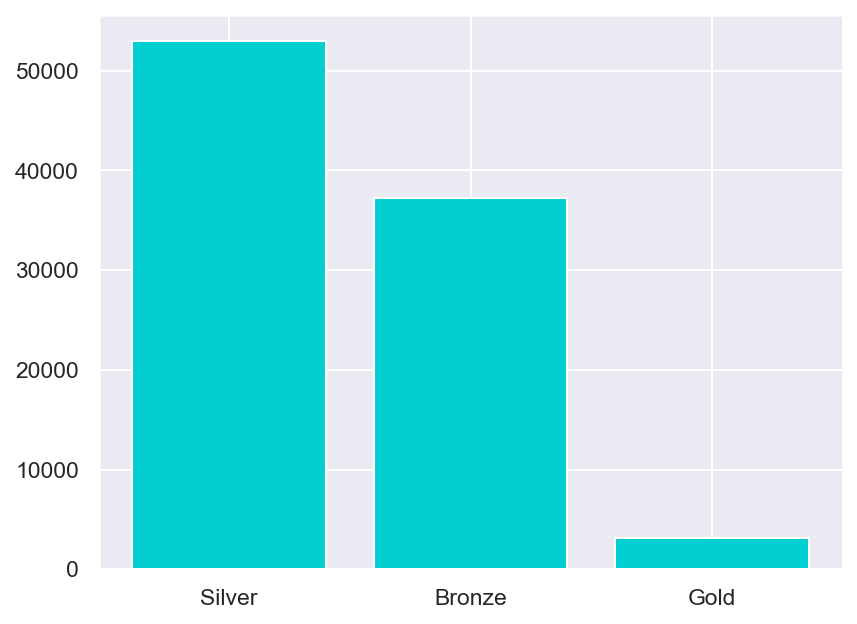

In [185]:
barplot = dict(rfm_score3['label'].value_counts())
bar_names = list(barplot.keys())
bar_values = list(barplot.values())
plt.bar(bar_names,bar_values, color='#00CED1')
print(pd.DataFrame(barplot, index=[' ']))

In [186]:
agg_resume = rfm_score3[["label", "Recency","Frequency","Monetary"]].groupby("label").agg(["mean","count","max"]).round()

In [187]:
print (agg_resume.sort_values([('Recency','count')],ascending=False))

       Recency             Frequency            Monetary                
          mean  count  max      mean  count max     mean  count      max
label                                                                   
Silver   307.0  52962  695       1.0  52962   4    246.0  52962  44048.0
Bronze   126.0  37256  300       1.0  37256   2     94.0  37256    499.0
Gold     389.0   3138  694       1.0   3138  15   1043.0   3138  45256.0


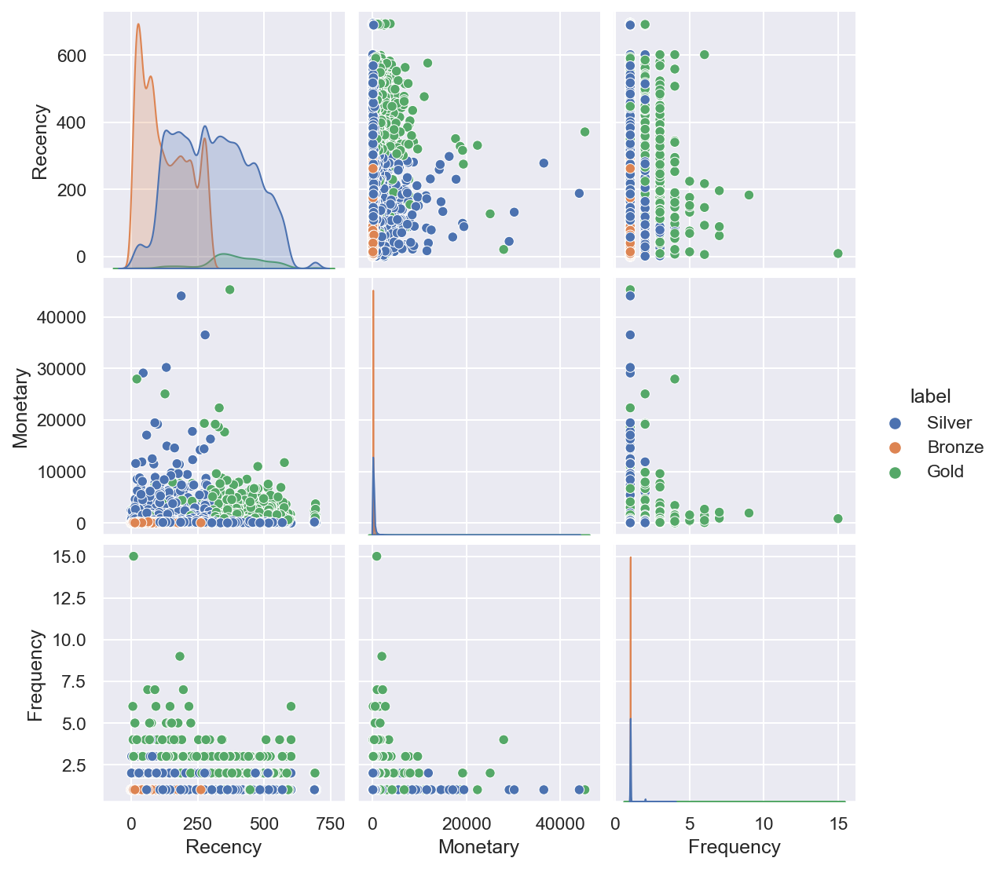

In [193]:
sns.pairplot(rfm_score3[['Recency','Monetary','Frequency', 'label']], hue="label")

plt.show()

# Export des fichiers RFM 

In [188]:
rfm.to_csv('data_P5_RFM.csv', index=False)

In [189]:
rfm.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 93356 entries, 0 to 93356
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   customer_unique_id  93356 non-null  object 
 1   Recency             93356 non-null  int64  
 2   Frequency           93356 non-null  int64  
 3   Monetary            93356 non-null  float64
dtypes: float64(1), int64(2), object(1)
memory usage: 5.6+ MB


In [190]:
rfm_transformed.to_csv('data_P5_RFM_transformed.csv', index=False)

In [191]:
df_mcommande.to_csv('data_P5_mcommande.csv', index=False)

In [192]:
df_mcommande.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115720 entries, 0 to 115719
Data columns (total 32 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115720 non-null  object        
 1   customer_id                    115720 non-null  object        
 2   order_status                   115720 non-null  object        
 3   order_purchase_timestamp       115720 non-null  datetime64[ns]
 4   order_approved_at              115705 non-null  datetime64[ns]
 5   order_delivered_carrier_date   115718 non-null  datetime64[ns]
 6   order_delivered_customer_date  115712 non-null  datetime64[ns]
 7   order_estimated_delivery_date  115720 non-null  datetime64[ns]
 8   customer_unique_id             115720 non-null  object        
 9   customer_zip_code_prefix       115720 non-null  object        
 10  customer_city                  115720 non-null  object        
 11  